In [1]:
# Importing necessary libraries and modules
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap
from IPython.display import display, Image

In [4]:
def spatial_chaos_8_nn(b, p, self_interaction, gens, n, condition, evolution_plot, fc_plot, theoretical_limit):
    
    # Initializing parameters
    nn = n * n  # Total number of cells (n x n grid)
    R, S, T, P = 1, 0, b, 0  # Payoff values
    payoff_matrix = np.array([[R, S], [T, P]])  # 2x2 payoff matrix

    # Color scheme: Blue for no change, Green for C to C, Yellow for D to D, Red for D to C
    color_matrix = ListedColormap([[0, 0, 1], [0, 1, 0], [1, 1, 0], [1, 0, 0]])

    # Transition matrix to track changes in strategies (1: C to C, 2: D to D, 3: D to C, 4: C to D)
    transitions = np.array([[1, 3], [2, 4]])

    # Array to track the cooperators' frequency over generations
    fc = np.zeros(gens)

    # Initializing payoff and lattice matrices
    payoff = np.zeros((n, n))  # Payoff matrix for each cell
    new_lattice = np.zeros((n, n))  # New strategy matrix after each round
    transition_matrix = np.zeros((n, n, gens))  # To track strategy transitions across generations
    lattice = np.ones((n, n))  # Initializing lattice with all cells as cooperators (C)

    # Initial condition: placing a defector (D) in the center or randomly populating based on "condition"
    if condition == 1:
        lattice[n // 2, n // 2] = 2  # Placing a single defector (D) in the center
    else:
        lattice_random = np.random.rand(n, n)  # Generating a random lattice
        lattice[lattice_random < p] = 2  # Populating lattice with defectors (D) based on probability p (proportion of defectors with values ranging from 0 to 1)

    # Main loop over generations
    for generation in range(gens):
        # Calculating the payoff for each cell based on neighbor strategy
        for row in range(n):
            for col in range(n):
                temp_payoff = 0  # Temporary variable to sum up payoffs for cell (row, col)
                for delta_row in range(-1, 2):
                    for delta_col in range(-1, 2):
                        # Case: skipping self-interaction
                        if self_interaction == 0 and delta_row == 0 and delta_col == 0:
                            continue
                        # Calculating the neighbor's coordinates
                        neighbor_row, neighbor_col = row + delta_row, col + delta_col
                        # Skipping if the neighbor is out of bounds
                        if neighbor_row < 0 or neighbor_row >= n or neighbor_col < 0 or neighbor_col >= n:
                            continue
                        # Adding the payoff from interaction with the neighbor
                        temp_payoff += payoff_matrix[int(lattice[row, col]) - 1, int(lattice[neighbor_row, neighbor_col]) - 1]
                payoff[row, col] = temp_payoff  # Updating the payoff matrix for cell (row, col)

        # Updating each cell's strategy based on the highest neighboring payoff
        for row in range(n):
            for col in range(n):
                max_payoff = payoff[row, col]  # Starting with the cell's own payoff
                strategy = lattice[row, col]  # Starting with the cell's own strategy
                for delta_row in range(-1, 2):
                    for delta_col in range(-1, 2):
                        # Case: no self-interaction
                        if self_interaction == 0 and delta_row == 0 and delta_col == 0:
                            continue
                        # Calculating the neighbor's coordinates
                        neighbor_row, neighbor_col = row + delta_row, col + delta_col
                        # Skipping if the neighbor is out of bounds
                        if neighbor_row < 0 or neighbor_row >= n or neighbor_col < 0 or neighbor_col >= n:
                            continue
                        # Case: If a neighbor has a higher payoff, adopt their strategy
                        if payoff[neighbor_row, neighbor_col] > max_payoff:
                            max_payoff = payoff[neighbor_row, neighbor_col]
                            strategy = lattice[neighbor_row, neighbor_col]
                new_lattice[row, col] = strategy  # Updating the new strategy for cell (row, col)

        # Updating the lattice and recording the transitions
        for row in range(n):
            for col in range(n):
                # Recording the transition type (C to C, D to D, D to C or C to D)
                transition_matrix[row, col, generation] = transitions[int(new_lattice[row, col]) - 1, int(lattice[row, col]) - 1]
                lattice[row, col] = new_lattice[row, col]  # Updating the lattice for the next generation

        # Calculating the cooperators' frequency (fraction of cells occupied by C)
        fc[generation] = np.sum((transition_matrix[:, :, generation] == 1) | (transition_matrix[:, :, generation] == 3)) / nn

    # Lattice evolution animation plot 
    if evolution_plot == 1:
        fig, ax = plt.subplots(figsize=(5, 5))  
        mat = ax.matshow(transition_matrix[:, :, 0], cmap=color_matrix)  # Initializing the plot with the first frame
        plt.subplots_adjust(top=0.85)  

        # Title
        ax.set_title(f'Spatial Prisoner\'s Dilemma\nb={b}, p={p}, self interaction={self_interaction}, theor. lim.={theoretical_limit}', pad=20)

        # Function to update the animation for each frame
        def update(frame):
            mat.set_data(transition_matrix[:, :, frame])  # Updating the lattice display for the current frame
            # Updating the title to reflect the current round and parameters
            ax.set_title(f'Generation: {frame + 1}\n'
                         f'b={b}, p={p}, self interaction={self_interaction}, theor. lim.={theoretical_limit}', pad=20)
            return [mat]

        # Creating the animation (update every 500 ms)
        ani = animation.FuncAnimation(fig, update, frames=gens, interval=500, blit=True)
        ani.save('evolution_animation.gif', writer='pillow', fps=10)  # Saving animation

        # Displaying the GIF
        display(Image(filename='evolution_animation.gif'))

    # Frequency of cooperators plot over time 
    if fc_plot == 1:
        plt.figure(figsize=(6, 4))   
        plt.plot(range(1, gens + 1), fc, '-p', color='purple', markersize=5, markeredgewidth=0.5)
        plt.xlabel('Generation')  
        plt.ylabel('Frequency of cooperators (fraction of sites occupied by C)')  
        # Title
        plt.title('SPATIAL PRISONER\'S DILEMMA\n'
                  f'b={b}, p={p}, self interaction={self_interaction}, theor. lim.={theoretical_limit}', pad=20)
        plt.grid(True) 
        
        # Case: If the theoretical limit is specified, draw a horizontal line at that value
        if theoretical_limit > 0:
            plt.axhline(y=theoretical_limit, color='k', linestyle='--') 
            plt.text(gens, theoretical_limit, str(theoretical_limit))  
        plt.show()


In [ ]:
# Figure 1a
spatial_chaos_8_nn(1.77, 0.1, 1, 200, 200, 0, 1, 1, 0)

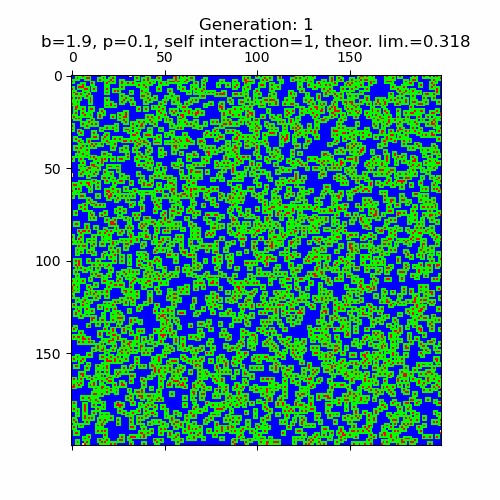

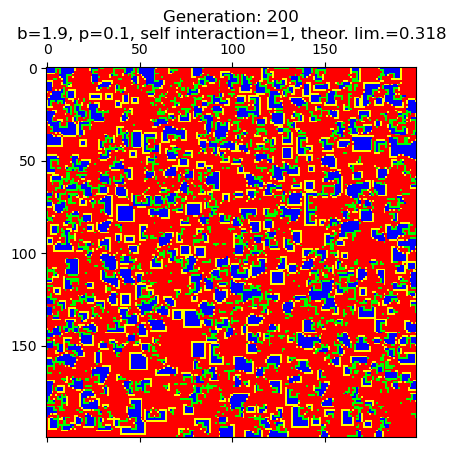

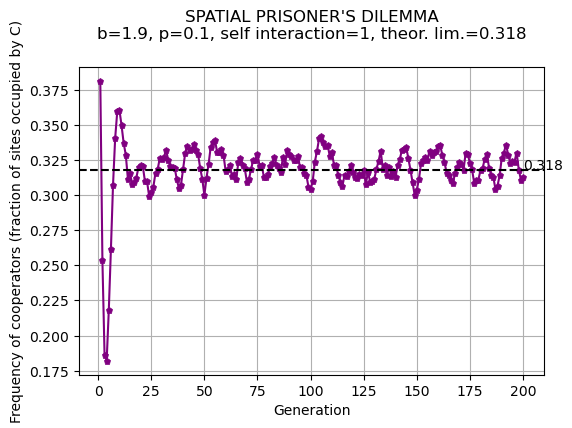

In [6]:
# Figure 1b
spatial_chaos_8_nn(1.9, 0.1, 1, 200, 200, 0, 1, 1, 0.318)

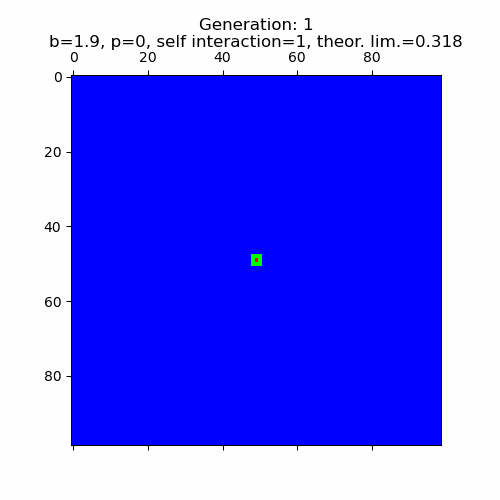

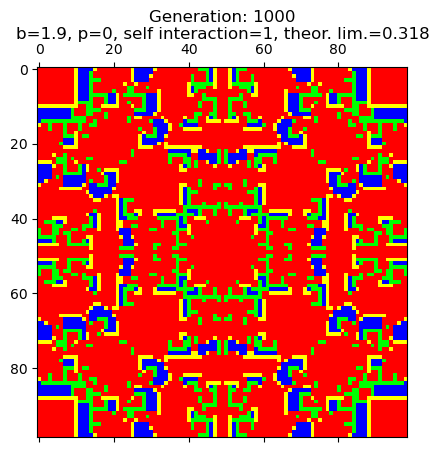

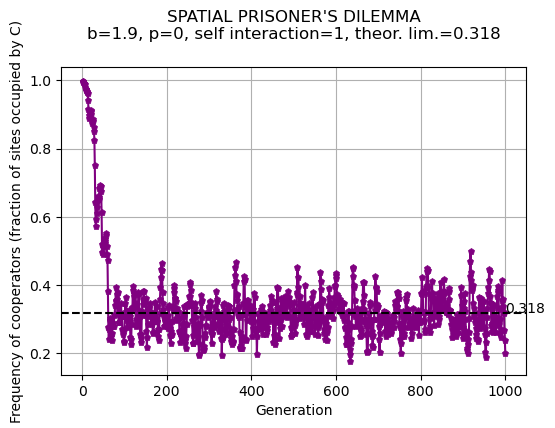

In [7]:
# Figures 3, 2b (single defector in the center)
spatial_chaos_8_nn(1.9, 0, 1, 1000, 99, 1, 1, 1, 0.318)

In [ ]:
# Figures similar to 3, 2b but with no self interaction
spatial_chaos_8_nn(1.63, 0.1, 0, 200, 200, 0, 1, 1, 0.299)

In [ ]:
# b=2 (area-of-interest's upper limit value )
spatial_chaos_8_nn(2, 0.1, 1, 70, 99, 0, 1, 1, 0)